# Planning Stage: Data Description & Exploratory Data Analysis and Visualization
### Group: 19
### Name: Divij Kapoor
### Student No.: 96858451
dataset: https://www.kaggle.com/datasets/rishikeshkonapure/hr-analytics-prediction/

In [1]:
library(tidyverse)
library(repr)
library(GGally)
library(digest)
library(infer)
library(gridExtra)
library(faraway)
library(broom)
library(leaps)
library(mltools)
options(repr.plot.width = 15, repr.plot.height = 12) 

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.1     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
Registered S3 method overwritten by 'GGally':
  method from   
  +.gg   ggplot2


Attaching package: ‘gridExtra’


The following object is masked from ‘package:dplyr’:

    combine



Attaching package: ‘faraway’


The following object is masked from ‘package:GGally’:

    happy



Attaching package: ‘mltools’


The following object is masked from ‘package:tidyr’:

    replace_na




In [2]:
data <- read.csv("HR-Employee-Attrition.csv")

In [3]:
# View structure, summary, and initial data
head(data)
summary(data)
dim(data) 

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,⋯,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
,<int>,<chr>,<chr>,<int>,<chr>,<int>,<int>,<chr>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,⋯,1,80,0,8,0,1,6,4,0,5
2,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,⋯,4,80,1,10,3,3,10,7,1,7
3,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,⋯,2,80,0,7,3,3,0,0,0,0
4,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,⋯,3,80,0,8,3,3,8,7,3,0
5,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,⋯,4,80,1,6,3,3,2,2,2,2
6,32,No,Travel_Frequently,1005,Research & Development,2,2,Life Sciences,1,8,⋯,3,80,0,8,2,2,7,7,3,6


      Age         Attrition         BusinessTravel       DailyRate     
 Min.   :18.00   Length:1470        Length:1470        Min.   : 102.0  
 1st Qu.:30.00   Class :character   Class :character   1st Qu.: 465.0  
 Median :36.00   Mode  :character   Mode  :character   Median : 802.0  
 Mean   :36.92                                         Mean   : 802.5  
 3rd Qu.:43.00                                         3rd Qu.:1157.0  
 Max.   :60.00                                         Max.   :1499.0  
  Department        DistanceFromHome   Education     EducationField    
 Length:1470        Min.   : 1.000   Min.   :1.000   Length:1470       
 Class :character   1st Qu.: 2.000   1st Qu.:2.000   Class :character  
 Mode  :character   Median : 7.000   Median :3.000   Mode  :character  
                    Mean   : 9.193   Mean   :2.913                     
                    3rd Qu.:14.000   3rd Qu.:4.000                     
                    Max.   :29.000   Max.   :5.000              

[1] 1470   35

In [4]:
sapply(data, class)

Age                Attrition           BusinessTravel 
               "integer"              "character"              "character" 
               DailyRate               Department         DistanceFromHome 
               "integer"              "character"                "integer" 
               Education           EducationField            EmployeeCount 
               "integer"              "character"                "integer" 
          EmployeeNumber  EnvironmentSatisfaction                   Gender 
               "integer"                "integer"              "character" 
              HourlyRate           JobInvolvement                 JobLevel 
               "integer"                "integer"                "integer" 
                 JobRole          JobSatisfaction            MaritalStatus 
             "character"                "integer"              "character" 
           MonthlyIncome              MonthlyRate       NumCompaniesWorked 
               "integer"                "integer"                "integer" 
                  Over18                 OverTime        PercentSalaryHike 
             "character"              "character"                "integer" 
       PerformanceRating RelationshipSatisfaction            StandardHours 
               "integer"                "integer"                "integer" 
        StockOptionLevel        TotalWorkingYears    TrainingTimesLastYear 
               "integer"                "integer"                "integer" 
         WorkLifeBalance           YearsAtCompany       YearsInCurrentRole 
               "integer"                "integer"                "integer" 
 YearsSinceLastPromotion     YearsWithCurrManager 
               "integer"                "integer"

# Dataset Summary

| **Variable**                | **Type**       | **Summary**                                                                 | **Description**                                                                                       |
|-----------------------------|----------------|-----------------------------------------------------------------------------|-------------------------------------------------------------------------------------------------------|
| `Age`                       | Integer        | Min: 18, Max: 60, Mean: 36.92                                               | Age of the employee in years                                                                          |
| `Attrition`                 | Categorical    | Yes: 16%, No: 84%                                                           | Whether the employee left the company                                                                 |
| `BusinessTravel`            | Categorical    | Rare: 70%, Frequent: 20%, Non-Travel: 10%                                   | Frequency of business travel                                                                          |
| `DailyRate`                 | Integer        | Min: 102, Max: 1499, Mean: 802.5                                            | Daily rate of pay for the employee                                                                    |
| `Department`                | Categorical    | Sales: 30%, R&D: 60%, HR: 10%                                               | Department the employee works in                                                                      |
| `DistanceFromHome`          | Integer        | Min: 1, Max: 29, Mean: 9.19                                                 | Distance between employee’s home and workplace (in miles)                                             |
| `Education`                 | Integer        | Min: 1, Max: 5, Median: 3                                                   | Level of education (1: Below College, 5: Doctor)                                                      |
| `EducationField`            | Categorical    | Life Sciences: 50%, Medical: 20%, Others                                    | Field of education                                                                                     |
| `EmployeeCount`             | Integer        | Always 1                                                                    | Constant value for all observations                                                                   |
| `EmployeeNumber`            | Integer        | Min: 1, Max: 2068                                                           | Unique identifier for each employee                                                                   |
| `EnvironmentSatisfaction`   | Integer        | Min: 1, Max: 4, Mean: 2.72                                                  | Satisfaction with work environment (1: Low, 4: High)                                                  |
| `Gender`                    | Categorical    | Male: 60%, Female: 40%                                                      | Gender of the employee                                                                                |
| `HourlyRate`                | Integer        | Min: 30, Max: 100, Mean: 65.89                                              | Hourly rate of pay for the employee                                                                   |
| `JobInvolvement`            | Integer        | Min: 1, Max: 4, Mean: 2.73                                                  | Job involvement (1: Low, 4: High)                                                                     |
| `JobLevel`                  | Integer        | Min: 1, Max: 5, Mean: 2.06                                                  | Level of the employee’s job                                                                           |
| `JobRole`                   | Categorical    | Various job roles (Sales Executive, Manager, etc.)                          | Specific job title of the employee                                                                    |
| `JobSatisfaction`           | Integer        | Min: 1, Max: 4, Mean: 2.73                                                  | Job satisfaction level                                                                                |
| `MaritalStatus`             | Categorical    | Single: 30%, Married: 40%, Divorced: 30%                                    | Marital status of the employee                                                                        |
| `MonthlyIncome`             | Integer        | Min: 1009, Max: 19999, Mean: 6503                                           | Monthly income of the employee                                                                        |
| `MonthlyRate`               | Integer        | Min: 2094, Max: 26999, Mean: 14313                                          | Monthly rate of pay for the employee                                                                  |
| `NumCompaniesWorked`        | Integer        | Min: 0, Max: 9, Mean: 2.69                                                  | Number of companies the employee has worked for                                                       |
| `Over18`                    | Categorical    | Always "Y"                                                                  | Whether the employee is over 18 years old                                                             |
| `OverTime`                  | Categorical    | Yes: 45%, No: 55%                                                           | Whether the employee works overtime                                                                   |
| `PercentSalaryHike`         | Integer        | Min: 11, Max: 25, Mean: 15.21                                               | Percentage salary hike during the last appraisal                                                      |
| `PerformanceRating`         | Integer        | Min: 3, Max: 4, Mean: 3.15                                                  | Performance rating (1: Low, 4: High)                                                                  |
| `RelationshipSatisfaction`  | Integer        | Min: 1, Max: 4, Mean: 2.71                                                  | Satisfaction with personal relationships                                                              |
| `StandardHours`             | Integer        | Always 80                                                                   | Standard work hours (constant)                                                                        |
| `StockOptionLevel`          | Integer        | Min: 0, Max: 3, Mean: 0.79                                                  | Level of stock options granted                                                                        |
| `TotalWorkingYears`         | Integer        | Min: 0, Max: 40, Mean: 11.28                                                | Total number of years worked by the employee                                                          |
| `TrainingTimesLastYear`     | Integer        | Min: 0, Max: 6, Mean: 2.80                                                  | Number of training sessions attended in the last year                                                 |
| `WorkLifeBalance`           | Integer        | Min: 1, Max: 4, Mean: 2.76                                                  | Work-life balance rating                                                                              |
| `YearsAtCompany`            | Integer        | Min: 0, Max: 40, Mean: 7.00                                                 | Number of years the employee has been with the company                                                |
| `YearsInCurrentRole`        | Integer        | Min: 0, Max: 18, Mean: 4.23                                                 | Number of years the employee has been in the current role                                             |
| `YearsSinceLastPromotion`   | Integer        | Min: 0, Max: 15, Mean: 2.19                                                 | Number of years since the last promotion                                                              |
| `YearsWithCurrManager`      | Integer        | Min: 0, Max: 17, Mean: 4.12                                                 | Number of years the employee has been with the current manager                                        |


The dataset is focused on employee attrition and includes various factors that could influence whether an employee stays or leaves a company. This dataset contains 1,470 observations and 35 columns, including information about demographics, job role, salary, satisfaction levels, and performance. The data originates from a HR analytics setting aimed at understanding employee attrition patterns.

# Research Question

**What factors contribute most to employee attrition?**

---

### Explanation

- **Response Variable (Dependent):** `Attrition`  
  - This is a categorical variable (`Yes` or `No`) indicating whether an employee has left the company.

- **Explanatory Variables (Independent):**
  To maintain interpretability and simplicity in the model, I’m focusing on a carefully selected subset of variables. These variables have been chosen to keep the model both understandable and effective, avoiding complex interactions and high correlation issues present in the full dataset. Although variables like `StockOptionLevel` may have an impact, they lack interpretability compared to more intuitive features like `MonthlyIncome`. By limiting the model to key variables, I aim to create a clear and straightforward model that still captures the essential patterns in the data.



  Below are potential predictors that could influence attrition:
  - **`Age`**: Older employees may be more likely to stay or leave depending on career goals.
  - **`MonthlyIncome`**: Lower income might increase the likelihood of attrition.
  - **`JobSatisfaction`**: Dissatisfied employees may be more likely to leave.
  - **`WorkLifeBalance`**: Poor balance could lead to higher attrition rates.
  - **`OverTime`**: Employees working overtime frequently might experience burnout.
  - **`YearsAtCompany`**: Employees with shorter tenures might leave more frequently.
  - **`DistanceFromHome`**: A long commute could influence attrition.
  - **`EnvironmentSatisfaction`**: Dissatisfaction with the work environment might increase attrition.

---

### Objective

This question is both **predictive** and **inferential**:
- **Predictive:** Develop a model to predict which employees are more likely to leave.
- **Inferential:** Identify and interpret the key drivers of attrition (e.g., which variables significantly influence an employee's decision to leave).

---

### Justification

Understanding the key drivers of attrition can help the company implement targeted retention strategies. By analyzing these factors, the organization can improve employee satisfaction, optimize resource allocation, and reduce costs associated with turnover.

# Exploratory Data Analysis and Visualization

Checking null values

In [5]:
colSums(is.na(data))

Age                Attrition           BusinessTravel 
                       0                        0                        0 
               DailyRate               Department         DistanceFromHome 
                       0                        0                        0 
               Education           EducationField            EmployeeCount 
                       0                        0                        0 
          EmployeeNumber  EnvironmentSatisfaction                   Gender 
                       0                        0                        0 
              HourlyRate           JobInvolvement                 JobLevel 
                       0                        0                        0 
                 JobRole          JobSatisfaction            MaritalStatus 
                       0                        0                        0 
           MonthlyIncome              MonthlyRate       NumCompaniesWorked 
                       0                        0                        0 
                  Over18                 OverTime        PercentSalaryHike 
                       0                        0                        0 
       PerformanceRating RelationshipSatisfaction            StandardHours 
                       0                        0                        0 
        StockOptionLevel        TotalWorkingYears    TrainingTimesLastYear 
                       0                        0                        0 
         WorkLifeBalance           YearsAtCompany       YearsInCurrentRole 
                       0                        0                        0 
 YearsSinceLastPromotion     YearsWithCurrManager 
                       0                        0

The dataset has no null values, minimal cleaning is required.

Making the categorical columns as factors

In [6]:
categorical_cols <- c("Attrition", "BusinessTravel", "Department", "EducationField", 
                      "Gender", "JobRole", "MaritalStatus", "Over18", "OverTime")
data[categorical_cols] <- lapply(data[categorical_cols], as.factor)

Important variables against Attrition as a ggpairs plot to see their relation with attrition and the co-relation between them

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


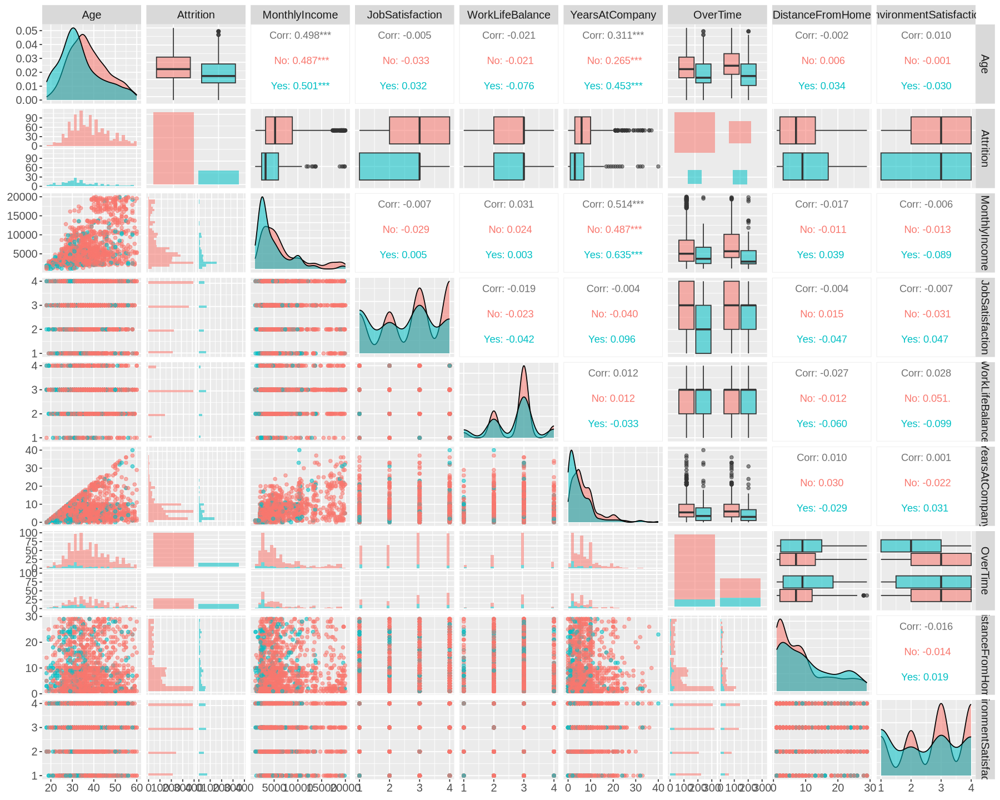

In [7]:
important_vars <- data %>%
  select(Age, Attrition, MonthlyIncome, JobSatisfaction, WorkLifeBalance, YearsAtCompany, OverTime, DistanceFromHome, EnvironmentSatisfaction)

# Plotting ggpairs
plot <- ggpairs(important_vars, 
        aes(color = Attrition, alpha = 0.6), 
        progress= FALSE) + 
theme(
    text = element_text(size = 15),
    plot.title = element_text(face = "bold"),
    axis.title = element_text(face = "bold")
  )

plot

### Attrition and Continuous Variables

- **Age vs. Attrition**: Employees who leave (Attrition = Yes) tend to be younger, as evident from the distribution skew toward lower age values.
- **Monthly Income and DistanceFromHome vs. Attrition**: No clear linear relationship is observed, though attrition is slightly more prevalent in lower income ranges.
- **YearsAtCompany vs. Attrition**: Similar to Age, employees with fewer years at the company are more likely to leave.

### Attrition and Categorical Variables

- **OverTime vs. Attrition**: A clear relationship is visible where employees working overtime tend to have higher attrition rates.
- **WorkLifeBalance, JobSatisfaction, and EnvironmentSatisfaction** do not show strong trends with attrition, indicating these may not be significant predictors. This contradicts the assumption before.

### Multicollinearity Concerns

- **Age and YearsAtCompany**: These two variables show a moderately strong positive correlation, suggesting multicollinearity.

Let's Look at a correlation heatmap of all the variables


Attaching package: ‘reshape2’


The following object is masked from ‘package:tidyr’:

    smiths


Warning message in cor(numeric_data, use = "complete.obs"):
“the standard deviation is zero”
Warning message:
“Removed 98 rows containing missing values or values outside the scale range
(`geom_text()`).”


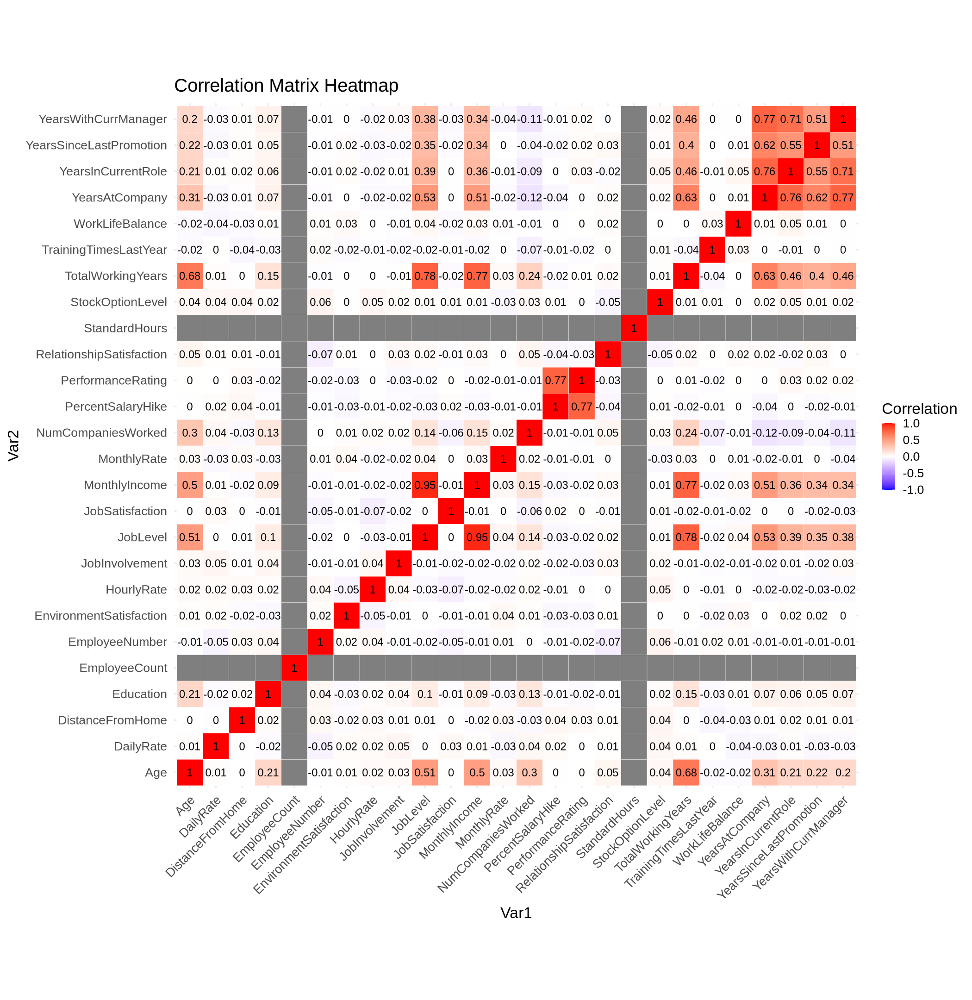

In [8]:
library(reshape2)

# Select only numeric variables
numeric_data <- data %>% select_if(is.numeric)

# Compute the correlation matrix
cor_matrix <- cor(numeric_data, use = "complete.obs")

# Melt the correlation matrix for ggplot
melted_cor_matrix <- melt(cor_matrix)

# Plot the correlation matrix heatmap with numbers
options(repr.plot.width = 17.5, repr.plot.height = 18) 
ggplot(data = melted_cor_matrix, aes(x = Var1, y = Var2, fill = value)) +
  geom_tile(color = "white") +
  scale_fill_gradient2(low = "blue", high = "red", mid = "white", 
                       midpoint = 0, limit = c(-1,1), space = "Lab", 
                       name = "Correlation") +
  theme_minimal(base_size = 20) + 
  theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1)) +
  coord_fixed() +
  labs(title = "Correlation Matrix Heatmap") +
  geom_text(aes(label = round(value, 2)), color = "black", size = 5)


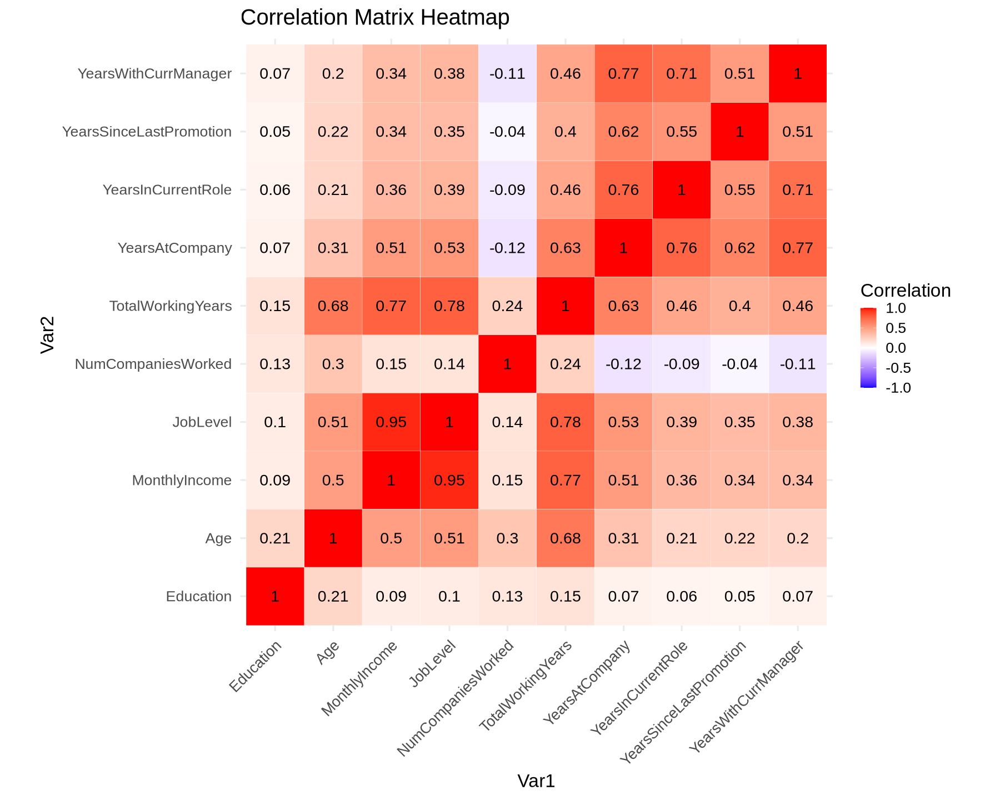

In [9]:
highcorrelation = data %>% select('Education','Age','MonthlyIncome','JobLevel','NumCompaniesWorked','TotalWorkingYears','YearsAtCompany',
       'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager')

cor_matrix <- cor(highcorrelation, use = "complete.obs")

# Melt the correlation matrix for ggplot
melted_cor_matrix <- melt(cor_matrix)

# Plot the correlation matrix heatmap with numbers
options(repr.plot.width = 15, repr.plot.height = 12) 
ggplot(data = melted_cor_matrix, aes(x = Var1, y = Var2, fill = value)) +
  geom_tile(color = "white") +
  scale_fill_gradient2(low = "blue", high = "red", mid = "white", 
                       midpoint = 0, limit = c(-1,1), space = "Lab", 
                       name = "Correlation") +
  theme_minimal(base_size = 20) + 
  theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1)) +
  coord_fixed() +
  labs(title = "Correlation Matrix Heatmap") +
  geom_text(aes(label = round(value, 2)), color = "black", size = 6)


These variables show a high degree of correlation—some even reaching a coefficient of 1—which is unsurprising given that most of them trend upwards with age. They’re all time-related, and including them could lead to multicollinearity issues in the model. To address this, I will select only YearsAtCompany, as it broadly encompasses the information provided by the other variables. This approach helps simplify the model, reduce redundancy, and maintain interpretability without compromising on relevant insights.

# Methods and Plan

The final variables I plan to use given the EDA are: 
- `JobSatisfaction`
- `WorkLifeBalance`
- `OverTime`
- `YearsAtCompany`
- `DistanceFromHome`
- `EnvironmentSatisfaction`

### Proposed Methodology:
To analyze the selected dataset and address the 2 questions (inferecnce and prediction) I choose to use logistic regression.

#### Baseline Model:
The first step will involve creating a baseline model that predicts the most frequently occurring target class. This provides a benchmark to evaluate the performance of other models.
This approach is essential to establish a lower bound for performance metrics. If the model I plan to use does not significantly outperform the baseline, its utility may be questioned.

#### Logistic Regression:
Using the subset of variables chosen, I will build a logistic regression model without interaction and higher order terms. 
Logistic regression is appropriate for this analysis because:
- The target variable is binary or categorical.
- It provides interpretable coefficients that measure the relationship between predictor variables and the likelihood of the target class.
- It is computationally efficient and well-suited for datasets without extreme nonlinearities.

Model performance will be evaluated using the confusion matrix, including precision, recall, p-value and AUC.

##### Assumptions: 
- Linearity: The relationship between the independent and dependent variables is linear.
- Independence: The residuals are independent. In other words, the residuals from one prediction have no effect on the residuals from another.
- Homoscedasticity: The variance of the errors is constant across all levels of the independent variables.
- Normality: For any fixed value of the independent variables, the dependent variable is normally distributed.

##### Weakness:
- Linearity Assumption: Linear regression assumes a linear relationship between the dependent and independent variables. This may not hold true for many real-world scenarios where relationships can be more complex.
- Sensitive to Outliers: Linear regression is sensitive to outliers, which can have a significant impact on the regression line and, consequently, prediction accuracy.
- Multicollinearity: Linear regression doesn’t handle multicollinearity well. Multicollinearity, a situation where two or more features are highly correlated, can make the model’s estimates less reliable.
- Overfitting and Underfitting: Linear regression can overfit with many input features and underfit if the relationship is complex and non-linear.
- Lack of Fit Tests: It’s challenging to define the complexity of the model (like degree in polynomial regression) as there’s no definitive way of determining which degree is best without trying all.

# Implementation of proposed model

In [10]:
# Load necessary libraries
library(dplyr)
library(caret)
library(ggplot2)
library(pROC)

# Split data into training and testing sets
set.seed(123)  # For reproducibility
train_index <- createDataPartition(data$Attrition, p = 0.8, list = FALSE)
train_data <- data[train_index, ]
test_data <- data[-train_index, ]

# Baseline Model: Predict the most frequent class
baseline_pred <- rep(levels(train_data$Attrition)[which.max(table(train_data$Attrition))], nrow(test_data))
baseline_accuracy <- mean(baseline_pred == test_data$Attrition)
cat("Baseline Accuracy:", baseline_accuracy, "\n")

# Logistic Regression Model
# Fit the model using selected variables (update 'selected_vars' with your chosen features)
selected_vars <- c("JobSatisfaction", "WorkLifeBalance", "OverTime", "YearsAtCompany", "DistanceFromHome", "EnvironmentSatisfaction")
formula <- as.formula(paste("Attrition ~", paste(selected_vars, collapse = " + ")))

logistic_model <- glm(formula, data = train_data, family = binomial)

# Predict on test data
logistic_pred_prob <- predict(logistic_model, newdata = test_data, type = "response")
logistic_pred_class <- ifelse(logistic_pred_prob > 0.5, "Yes", "No")

# Convert predictions and actual target to factors
logistic_pred_class <- as.factor(logistic_pred_class)
actual_class <- as.factor(test_data$Attrition)

# Confusion Matrix and Metrics
logistic_confusion_matrix <- confusionMatrix(
    data = logistic_pred_class,
    reference = actual_class,
    positive = "Yes"  # Specify the positive class
)

logistic_confusion_matrix

options(repr.plot.width = 8, repr.plot.height = 8)
roc_obj <- roc(test_data$Attrition, logistic_pred_prob)
auc_value <- auc(roc_obj)
cat("AUC Value:", auc_value, "\n")

# Plot ROC Curve
# plot(roc_obj, col = "blue", lwd = 3, main = "ROC Curve for Logistic Regression", print.auc=TRUE)


Loading required package: lattice


Attaching package: ‘lattice’


The following object is masked from ‘package:faraway’:

    melanoma



Attaching package: ‘caret’


The following object is masked from ‘package:purrr’:

    lift


Type 'citation("pROC")' for a citation.


Attaching package: ‘pROC’


The following objects are masked from ‘package:stats’:

    cov, smooth, var




Baseline Accuracy: 0.8395904 


Confusion Matrix and Statistics

          Reference
Prediction  No Yes
       No  243  42
       Yes   3   5
                                          
               Accuracy : 0.8464          
                 95% CI : (0.7999, 0.8857)
    No Information Rate : 0.8396          
    P-Value [Acc > NIR] : 0.4123          
                                          
                  Kappa : 0.1418          
                                          
 Mcnemar's Test P-Value : 1.473e-08       
                                          
            Sensitivity : 0.10638         
            Specificity : 0.98780         
         Pos Pred Value : 0.62500         
         Neg Pred Value : 0.85263         
             Prevalence : 0.16041         
         Detection Rate : 0.01706         
   Detection Prevalence : 0.02730         
      Balanced Accuracy : 0.54709         
                                          
       'Positive' Class : Yes             
                              

Setting levels: control = No, case = Yes

Setting direction: controls < cases



AUC Value: 0.7541948 


# Interpretation of the results

The model achieved an accuracy of 84.64%, which is slightly better than the baseline (83.96%), but its sensitivity (10.64%) is very low, indicating poor performance in identifying positive cases (Attrition = Yes). While the AUC value of 0.754 suggests moderate discriminatory ability, the imbalance in the dataset, as shown by the prevalence of only 16.04% for the positive class, likely caused the model to favor the majority class (This also explains the high p-value). To improve the model, we might explore using interaction terms and higher-order terms, as these could capture non-linear relationships or interactions among variables. To determine the best set of features, we could employ stepwise regression (backwards, forward, or hybrid approaches), which systematically evaluates and selects predictors based on their contribution to the model. Additionally, alternative metrics like precision-recall and ROC curves (which were not chosen because the task restricts us to only one visualization or table to report results and we chose the confusion matrix and its corresponding metrics) may provide more meaningful insights into the model's performance for the minority class.